In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
from tqdm import tqdm
from collections import defaultdict
import time
import copy
import gc
import torchvision
import matplotlib.pyplot as plt
import os
from torch.utils.data import Dataset
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image
from torch.utils.data import random_split

import matplotlib.pyplot as plt
import numpy as np

# Process Data

In [2]:
len(os.listdir("K-01/image")) + len(os.listdir("K-03/image"))

785

In [3]:
len(os.listdir("K-01/indexLabel")) + len(os.listdir("K-03/indexLabel"))

1499

In [4]:
class K13Dataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []
        
        # Only use K-01 and K-03 folders
        use_folders = ['K-01', 'K-03']
        
        for folder in use_folders:
            folder_path = os.path.join(root_dir, folder)
            if os.path.isdir(folder_path):
                image_dir = os.path.join(folder_path, 'image')
                label_dir = os.path.join(folder_path, 'indexLabel')
                
                # Match image and label files
                for img_name in os.listdir(image_dir):
                    img_path = os.path.join(image_dir, img_name)
                    label_path = os.path.join(label_dir, img_name)
                    
                    if os.path.exists(label_path):
                        self.samples.append((img_path, label_path))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label_path = self.samples[idx]
        
        # Load image
        image = Image.open(img_path).convert('RGB').resize((256, 256))
        label = Image.open(label_path).resize((256, 256), Image.NEAREST)
        
        if self.transform:
            image = self.transform(image)
        label = torch.tensor(np.array(label), dtype=torch.long)
        
        return image, label

    def split_dataset(self, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
        assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 1e-5, "Ratios must sum to 1"
        
        dataset_size = len(self)
        train_size = int(train_ratio * dataset_size)
        val_size = int(val_ratio * dataset_size)
        test_size = dataset_size - train_size - val_size

        return random_split(self, [train_size, val_size, test_size])



In [5]:

# Define your transformations
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Create the dataset
full_dataset = K13Dataset(root_dir='', transform=transform)

len(full_dataset)


609

## Split the dataset

In [6]:
# Split the dataset
train_dataset, val_dataset, test_dataset = full_dataset.split_dataset()

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=14)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=14)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=14)

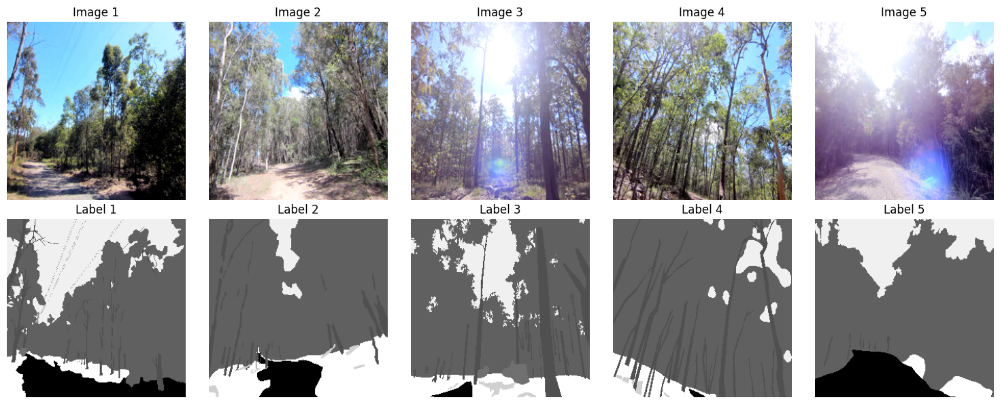

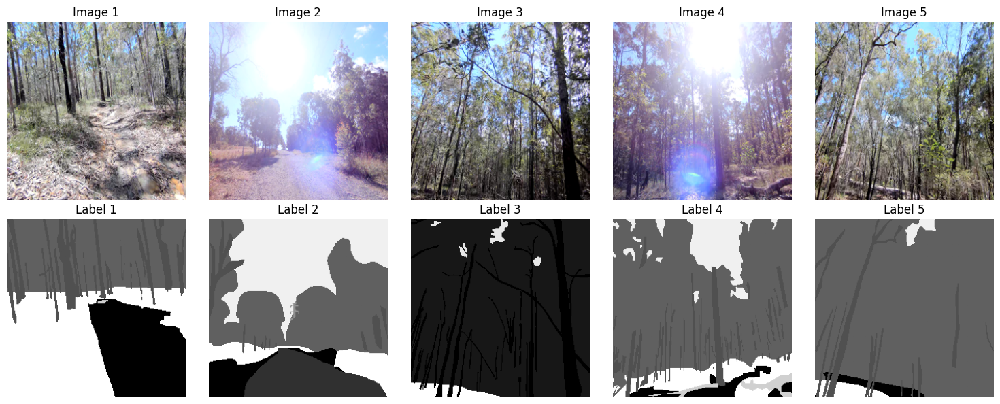

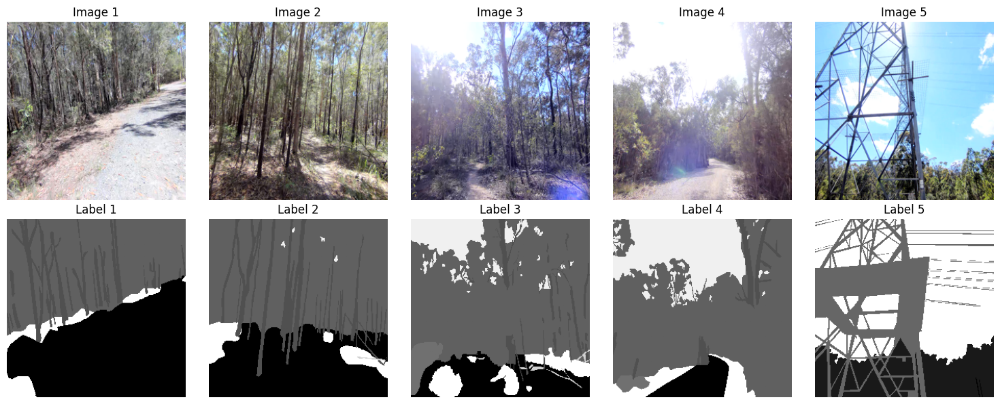

In [7]:


def visualize_batch(dataloader, num_images=5):
    # Get a batch of images
    images, labels = next(iter(dataloader))
    
    # Convert tensors to numpy arrays
    images = images.numpy()
    labels = labels.numpy()
    
    # Create a grid of subplots
    fig, axes = plt.subplots(2, num_images, figsize=(15, 6))
    
    for i in range(num_images):
        # Display image
        axes[0, i].imshow(np.transpose(images[i], (1, 2, 0)))
        axes[0, i].axis('off')
        axes[0, i].set_title(f'Image {i+1}')
        
        # Display label (assuming labels are images too)
        axes[1, i].imshow(labels[i], cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title(f'Label {i+1}')
    
    plt.tight_layout()
    plt.show()

# Visualize a batch from the train loader
visualize_batch(train_loader)

# Visualize a batch from the validation loader
visualize_batch(val_loader)

# Visualize a batch from the test loader
visualize_batch(test_loader)

In [8]:
len(train_dataset), len(val_dataset), len(test_dataset)

(426, 91, 92)

# Runner

In [9]:


class ModelTrainValid:
    def __init__(self, model, device, num_classes, train_loader, valid_loader, test_loader, optimizer):
        self.model = model
        self.device = device
        self.num_classes = num_classes
        self.train_loader = train_loader
        self.valid_loader = valid_loader
        self.test_loader = test_loader
        self.optimizer = optimizer
        self.criterion = nn.CrossEntropyLoss()


    def train_one_epoch(self, epoch):
        self.model.train()
        dataset_size = 0
        running_loss = 0.0
        pbar = tqdm(enumerate(self.train_loader), total=len(self.train_loader), desc='Training')
        for step, (images, masks) in pbar:
            images, masks = images.to(self.device), masks.to(self.device)
            self.optimizer.zero_grad()
            y_pred = self.model(images)['out']
            # print(y_pred)
            # print(masks)
            loss = self.criterion(y_pred, masks)
            loss.backward()
            self.optimizer.step()

            running_loss += (loss.item() * images.size(0))
            dataset_size += images.size(0)
            epoch_loss = running_loss / dataset_size

            mem = torch.cuda.memory_reserved() / 1E9 if torch.cuda.is_available() else 0
            current_lr = self.optimizer.param_groups[0]['lr']
            pbar.set_postfix(epoch=epoch, train_loss=epoch_loss, lr=current_lr, gpu_mem=f'{mem:.2f} GB')

        return epoch_loss

    def valid_one_epoch(self, epoch):
        self.model.eval()
        running_loss = 0.0
        dataset_size = 0
        pbar = tqdm(enumerate(self.valid_loader), total=len(self.valid_loader), desc='Validating')
        with torch.no_grad():
            for step, (images, masks) in pbar:
                images, masks = images.to(self.device), masks.to(self.device)
                y_pred = self.model(images)['out']
                loss = self.criterion(y_pred, masks)
                running_loss += (loss.item() * images.size(0))
                dataset_size += images.size(0)
                epoch_loss = running_loss / dataset_size

                y_pred = torch.sigmoid(y_pred)

                mem = torch.cuda.memory_reserved() / 1E9 if torch.cuda.is_available() else 0
                pbar.set_postfix(valid_loss=epoch_loss, lr=self.optimizer.param_groups[0]['lr'], gpu_memory=f'{mem:.2f} GB')
                
        return epoch_loss

    def do_training(self, num_epochs, save_name):
        best_loss = np.inf
        best_model_wts = copy.deepcopy(self.model.state_dict())
        result = defaultdict(list)

        for epoch in range(1, num_epochs + 1):
            print(f'Epoch {epoch}/{num_epochs}')
            train_loss = self.train_one_epoch(epoch)
            val_loss = self.valid_one_epoch(epoch)

            result['Train Loss'].append(train_loss)
            result['Valid Loss'].append(val_loss)

            if val_loss < best_loss:
                best_loss = val_loss
                best_model_wts = copy.deepcopy(self.model.state_dict())
                torch.save(self.model.state_dict(), f'{save_name}_best_model.pth')
                print(f'Saved Best Model')
                self.mIoU_compute(self.valid_loader)
                print("plot valid image")
                self.plot_images(self.valid_loader)

            torch.save(self.model.state_dict(), f'{save_name}_last_model.pth')

        self.model.load_state_dict(best_model_wts)
        return self.model, result
    

    def mIoU_compute(self, dataloder):
        self.model.eval()
        hist = np.zeros((self.num_classes, self.num_classes))
        with torch.no_grad():
            pbar = tqdm(enumerate(dataloder), total=len(dataloder), desc='compute_mIoU')
            for step, (images, gt_img) in pbar:
                images = images.to(self.device)
                gt_img = gt_img.to(self.device)
                pred = self.model(images)['out']
                pred = torch.argmax(pred, dim=1).detach().cpu().numpy()
                label = gt_img.detach().cpu().numpy()
                for i in range(len(label)):
                    k = (label[i] >= 0) & (label[i] < num_classes)
                    hist += np.bincount(num_classes * label[i][k].astype(int) + pred[i][k], minlength=num_classes**2).reshape(num_classes, num_classes)
        IoUs = np.diag(hist) / np.maximum(hist.sum(1) + hist.sum(0) - np.diag(hist), 1)
        PA_Recall = np.diag(hist) / np.maximum(hist.sum(1), 1)
        Precision = np.diag(hist) / np.maximum(hist.sum(0), 1)
        Accuracy = np.sum(np.diag(hist)) / np.maximum(np.sum(hist), 1)
        # result_data = {name_classes[i]: (IoUs[i], PA_Recall[i], Precision[i]) for i in range(num_classes)}
        print('Validation metric:')
        print(f'mIoU: {np.nanmean(IoUs) * 100:.2f}')
        print(f'mPA: {np.nanmean(PA_Recall) * 100:.2f}')
        print(f'Accuracy: {Accuracy * 100:.2f}')
        return IoUs, PA_Recall, Precision

    def plot_images(self, dataloader, num_images=4, nrow=2):
        self.model.eval()
        images_list = []
        labels_list = []
        preds_list = []
        with torch.no_grad():
            image_count = 0
            for images, labels in dataloader:
                images, labels = images.to(self.device), labels.to(self.device)
                outputs = self.model(images)['out']
                preds = torch.argmax(outputs, dim=1)
                images_list.append(images.cpu())
                labels_list.append(labels.cpu())
                preds_list.append(preds.cpu())
                image_count += images.size(0)
                if image_count >= num_images:
                    break
            images_grid = torch.cat(images_list)[:num_images]
            labels_grid = torch.cat(labels_list)[:num_images]
            preds_grid = torch.cat(preds_list)[:num_images]
            fig, axs = plt.subplots(1, 3, figsize=(18, 6))  # 1 row, 3 columns
            self.show_grid(images_grid, "Input Images", nrow, axs[0])
            self.show_grid(labels_grid.unsqueeze(1).float(), "Ground Truth Labels", nrow, axs[1])
            self.show_grid(preds_grid.unsqueeze(1).float(), "Model Predictions", nrow, axs[2])
            plt.tight_layout()
            plt.show()
    

    @staticmethod
    def show_grid(tensor, title, nrow, ax):
        grid = torchvision.utils.make_grid(tensor, nrow=nrow, padding=2, normalize=True)
        ax.imshow(grid.permute(1, 2, 0))
        ax.set_title(title)
        ax.axis('off')


In [10]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
name_classes = [
    "unlabelled", "asphalt", "dirt", "mud", "water", "gravel", 
    "other-terrain", "tree-trunk", "tree-foliage", "bush", 
    "fence", "structure", "pole", "vehicle", "rock", "log", 
    "other-object", "sky", "grass",
    ]
num_classes = len(name_classes)
batch_size=16




# Model

## FCN

In [11]:
model_fcn = torchvision.models.segmentation.fcn_resnet50(pretrained=True)
model_fcn.classifier

FCNHead(
  (0): Conv2d(2048, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU()
  (3): Dropout(p=0.1, inplace=False)
  (4): Conv2d(512, 21, kernel_size=(1, 1), stride=(1, 1))
)

In [12]:

class MyHead(nn.Module):
    def __init__(self, num_classes):
        super(MyHead, self).__init__()
        self.classifier = nn.Sequential(
            nn.Conv2d(2048, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False),
            nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.ReLU(),
            nn.Dropout(p=0.1, inplace=False),
            nn.Conv2d(512, num_classes, kernel_size=(1, 1), stride=(1, 1))
        )
    def forward(self,x):
        return self.classifier(x)

model_fcn.classifier = MyHead(num_classes)


In [13]:
model_fcn.to(device)

optimizer = optim.Adam(model_fcn.parameters(), lr=1e-4, weight_decay=1e-6)

Epoch 1/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.46it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=1.06]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.47it/s]

Validation metric:
mIoU: 14.45
mPA: 19.92
Accuracy: 72.86
plot valid image


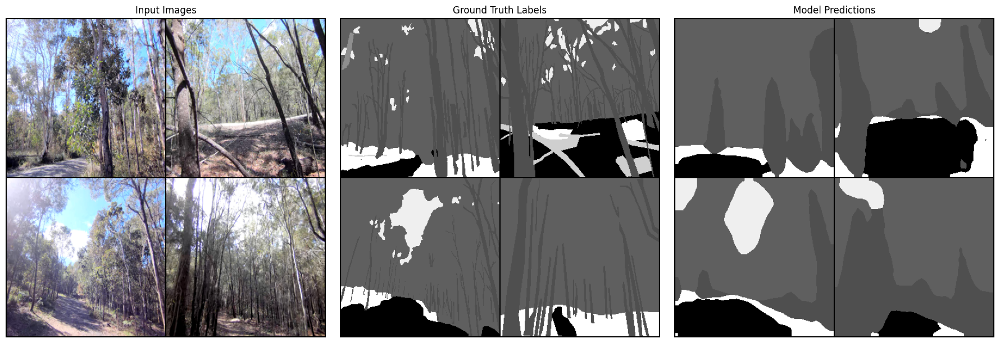

Epoch 2/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.76it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.673]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.65it/s]

Validation metric:
mIoU: 17.53
mPA: 21.60
Accuracy: 79.87
plot valid image


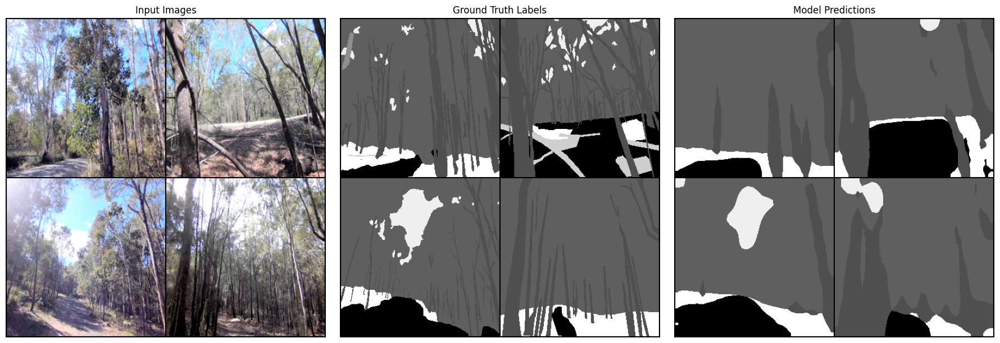

Epoch 3/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.10it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.592]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.54it/s]

Validation metric:
mIoU: 22.18
mPA: 27.32
Accuracy: 81.38
plot valid image


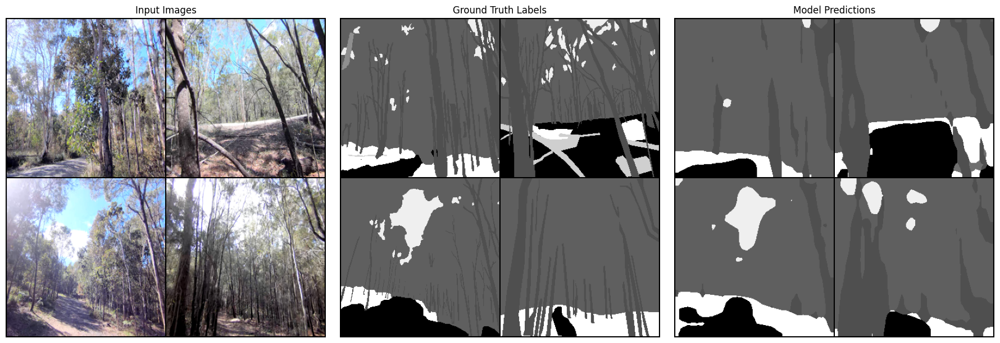

Epoch 4/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.79it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.561]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.36it/s]

Validation metric:
mIoU: 22.84
mPA: 28.77
Accuracy: 81.68
plot valid image


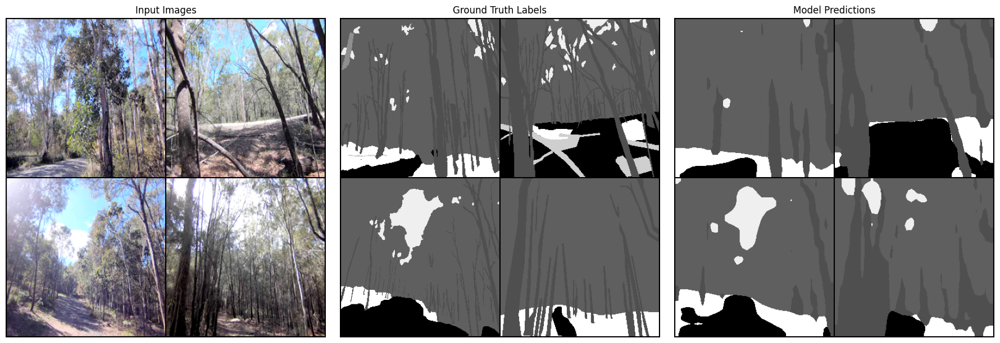

Epoch 5/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.84it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.542]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.69it/s]

Validation metric:
mIoU: 23.28
mPA: 29.61
Accuracy: 81.55
plot valid image


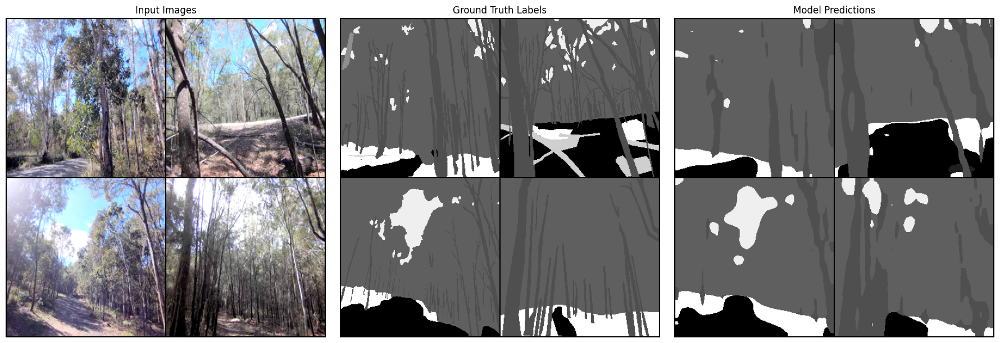

Epoch 6/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.83it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.533]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.70it/s]

Validation metric:
mIoU: 24.53
mPA: 32.32
Accuracy: 81.86
plot valid image


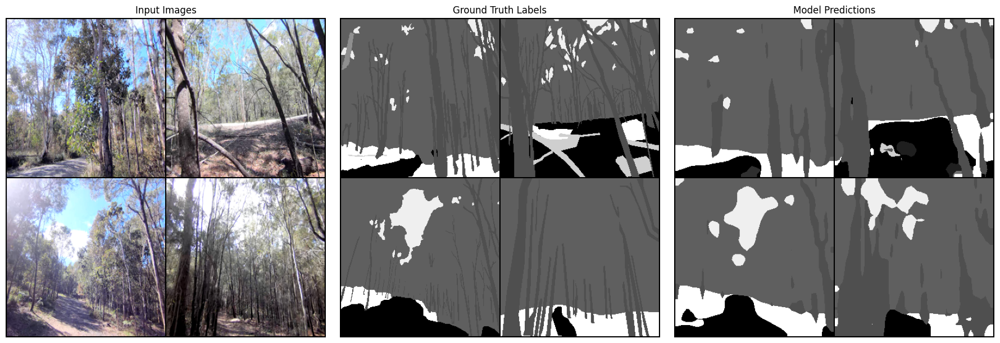

Epoch 7/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.62it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.504]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.39it/s]

Validation metric:
mIoU: 30.26
mPA: 38.16
Accuracy: 82.23
plot valid image


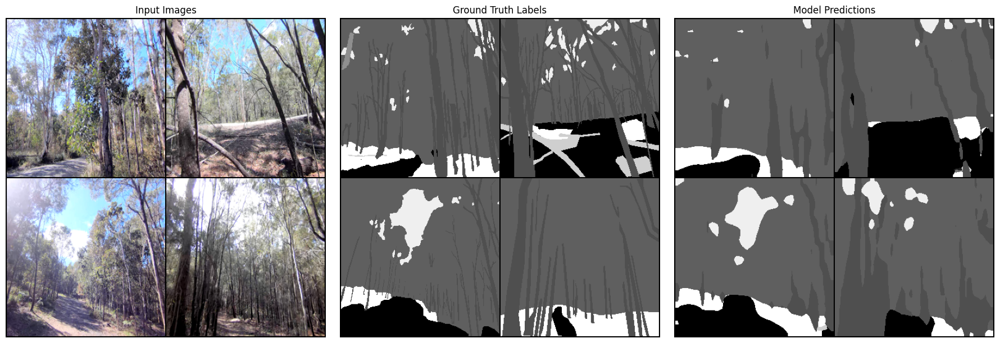

Epoch 8/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.50it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.507]


Epoch 9/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.62it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.504]


Epoch 10/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.80it/s, gpu_memory=5.41 GB, lr=0.0001, valid_loss=0.513]


In [14]:
runner = ModelTrainValid(model_fcn, device, num_classes, train_loader, val_loader, test_loader, optimizer)
model_fcn, history = runner.do_training(num_epochs=10, save_name='model_fcn')

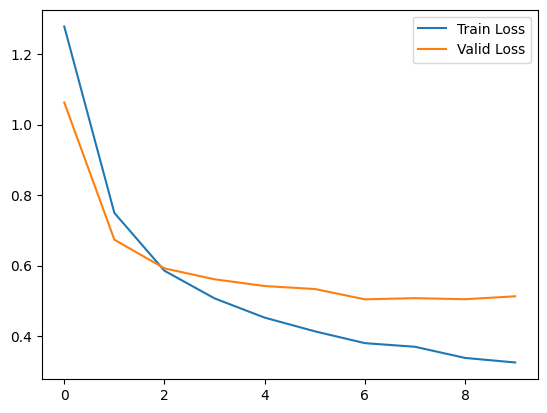

In [21]:
import pandas as pd
df = pd.DataFrame(history)
df.plot()
plt.show()

### Test

In [23]:
result_each_class = runner.mIoU_compute(runner.test_loader)

compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.20it/s]

Validation metric:
mIoU: 26.63
mPA: 33.26
Accuracy: 81.96


In [25]:
IoUs, PA_Recall, Precision = result_each_class

In [26]:
result_data = {name_classes[i]: (IoUs[i], PA_Recall[i], Precision[i]) for i in range(num_classes)}

In [29]:
result_df = pd.DataFrame(result_data).T
result_df.rename(columns={0: 'IoU', 1:'PA_Recal', 2:'Precision'}, inplace=True)
result_df

,IoU,PA_Recal,Precision
unlabelled,0.000000,0.000000,0.000000
asphalt,0.000000,0.000000,0.000000
dirt,0.638809,0.795068,0.764725
mud,0.311921,0.410774,0.564488
water,0.342543,0.474915,0.551358
gravel,0.665841,0.889301,0.726016
other-terrain,0.086142,0.090909,0.621622
tree-trunk,0.389799,0.481214,0.672339
tree-foliage,0.808877,0.933054,0.858713
bush,0.085013,0.147111,0.167635


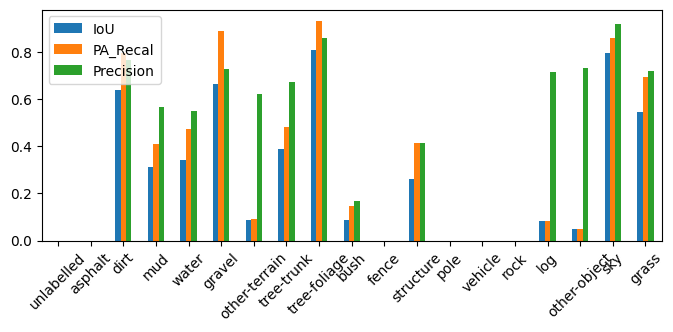

In [33]:
result_df.plot(kind='bar', figsize=(8, 3), rot=45)
plt.show()

## Deeplabv3

In [39]:
from torchvision.models.segmentation.deeplabv3 import DeepLabHead

model_deeplabv3 = torchvision.models.segmentation.deeplabv3_resnet50(pretrained=True)

model_deeplabv3.classifier = DeepLabHead(2048, num_classes)


Epoch 1/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.72it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=1.49]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.56it/s]

Validation metric:
mIoU: 13.73
mPA: 18.74
Accuracy: 73.75
plot valid image


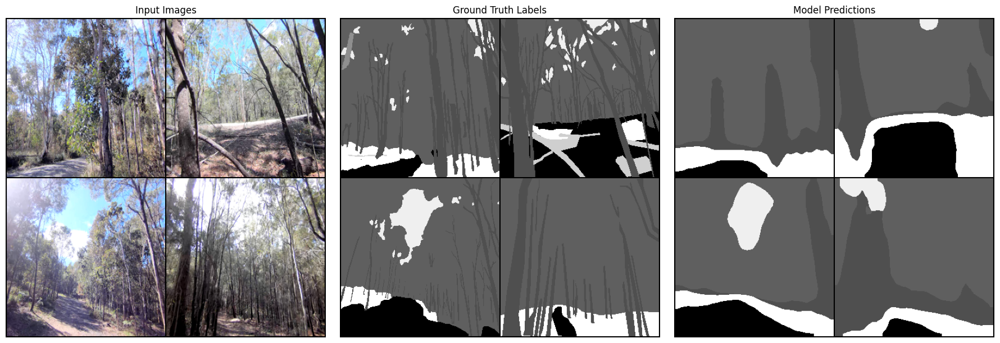

Epoch 2/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.72it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.956]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]

Validation metric:
mIoU: 15.21
mPA: 19.63
Accuracy: 78.56
plot valid image


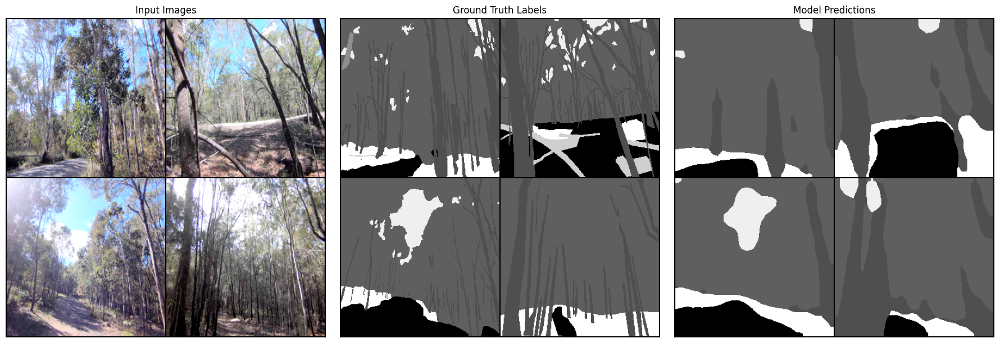

Epoch 3/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.69it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.8]  


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]

Validation metric:
mIoU: 18.43
mPA: 22.87
Accuracy: 80.32
plot valid image


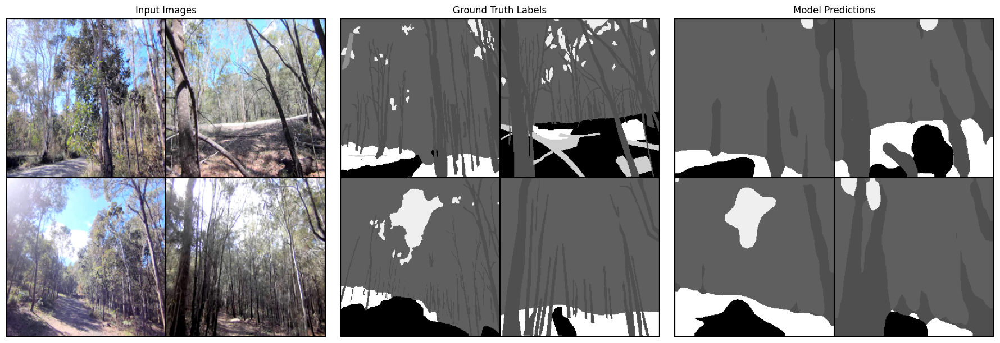

Epoch 4/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.62it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.717]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.56it/s]

Validation metric:
mIoU: 18.67
mPA: 22.87
Accuracy: 80.86
plot valid image


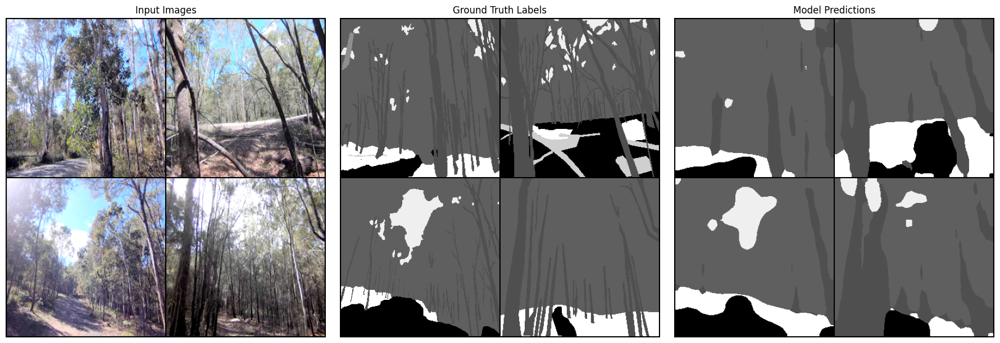

Epoch 5/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.65it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.667]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.58it/s]

Validation metric:
mIoU: 22.27
mPA: 27.65
Accuracy: 81.43
plot valid image


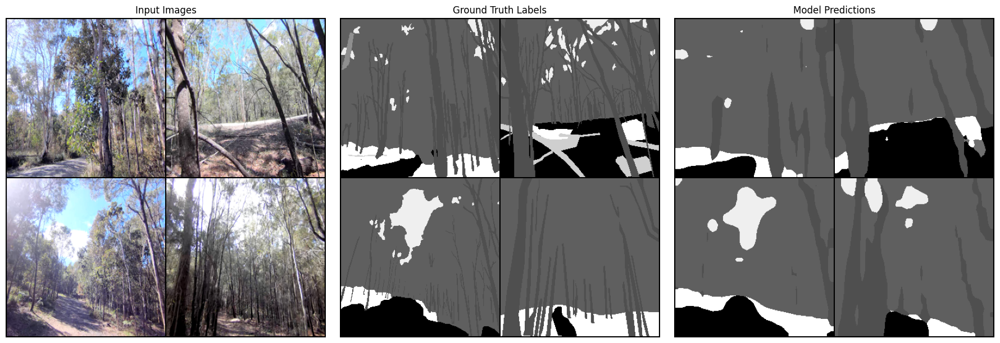

Epoch 6/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.61it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.636]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.53it/s]

Validation metric:
mIoU: 21.87
mPA: 28.12
Accuracy: 81.38
plot valid image


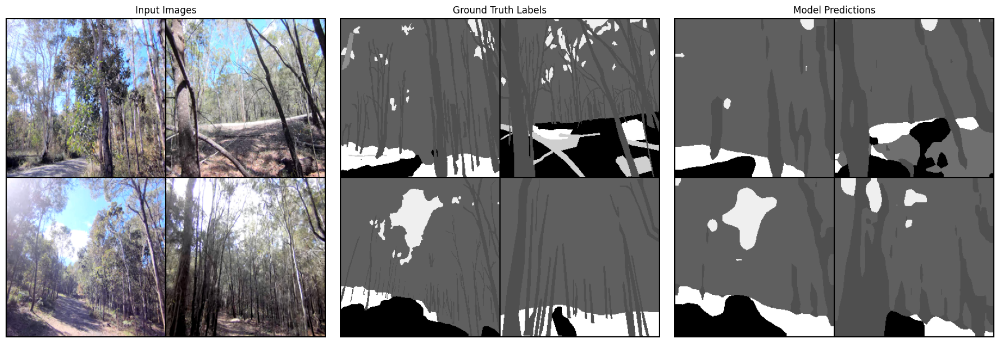

Epoch 7/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.21it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.604]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]

Validation metric:
mIoU: 22.58
mPA: 27.71
Accuracy: 81.97
plot valid image


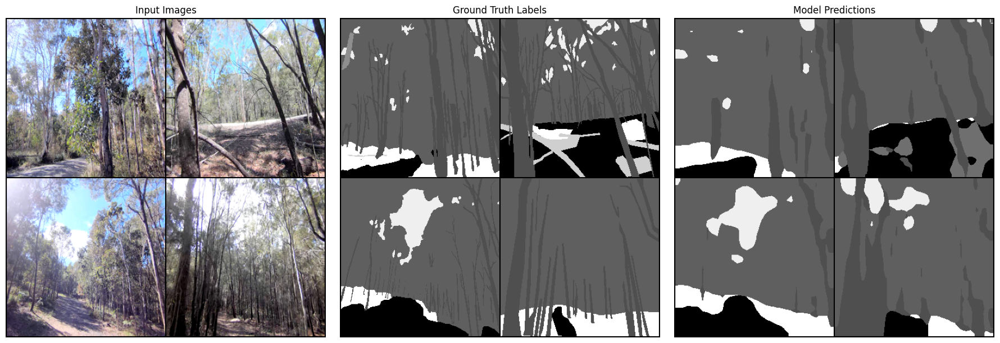

Epoch 8/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.22it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.591]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

Validation metric:
mIoU: 22.86
mPA: 28.72
Accuracy: 81.82
plot valid image


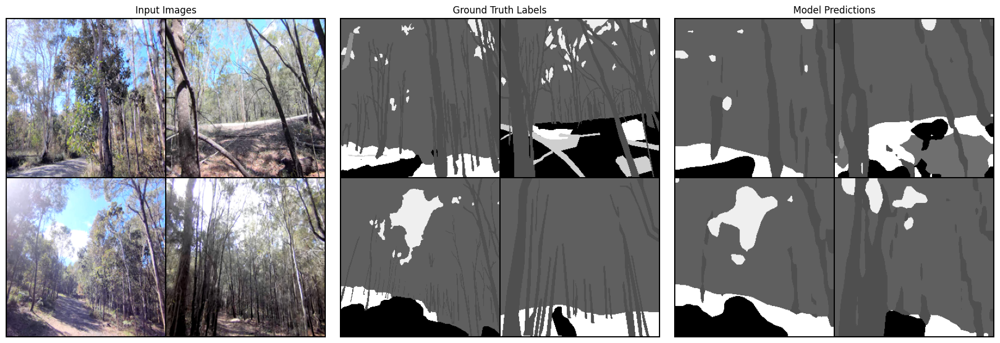

Epoch 9/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.59it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.573]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]

Validation metric:
mIoU: 21.80
mPA: 27.43
Accuracy: 81.86
plot valid image


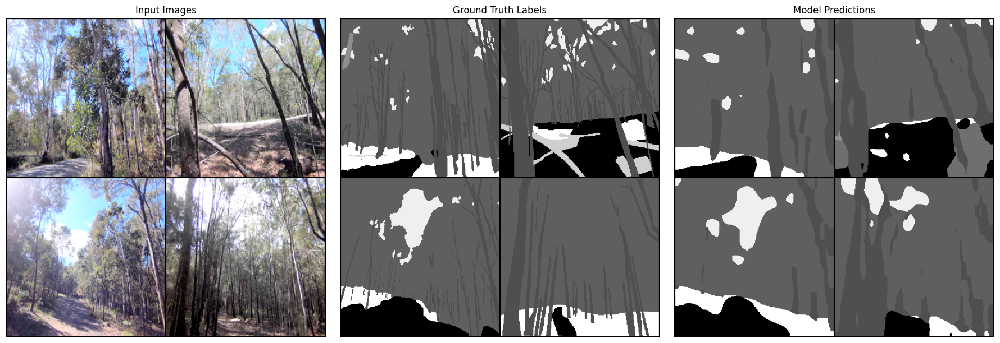

Epoch 10/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.59it/s, gpu_memory=7.21 GB, lr=0.0001, valid_loss=0.565]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.45it/s]

Validation metric:
mIoU: 22.70
mPA: 28.22
Accuracy: 81.89
plot valid image


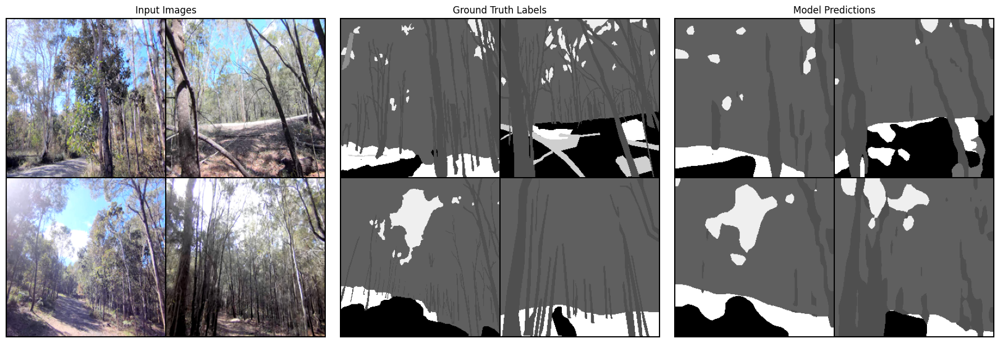

In [40]:
model_deeplabv3.to(device)

optimizer = optim.Adam(model_deeplabv3.parameters(), lr=1e-4, weight_decay=1e-6)

runner = ModelTrainValid(model_deeplabv3, device, num_classes, train_loader, val_loader, test_loader, optimizer)
model_deeplabv3, history_deeplabv3 = runner.do_training(num_epochs=10, save_name='deeplabv3')

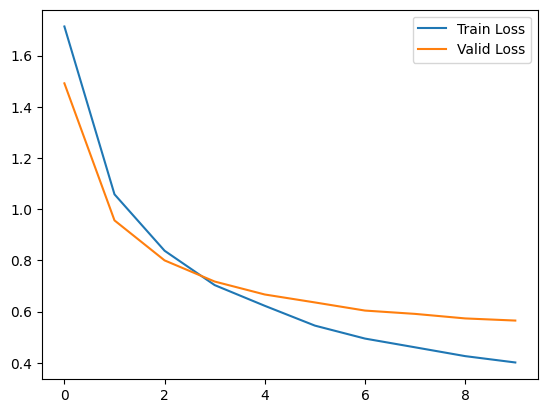

In [41]:
df = pd.DataFrame(history_deeplabv3)
df.plot()
plt.show()

### test

In [42]:
IoUs, PA_Recall, Precision = runner.mIoU_compute(runner.test_loader)

compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.38it/s]

Validation metric:
mIoU: 22.61
mPA: 27.67
Accuracy: 82.27


In [43]:
result_data_deeplabv3 = {name_classes[i]: (IoUs[i], PA_Recall[i], Precision[i]) for i in range(num_classes)}

result_df_deeplabv3 = pd.DataFrame(result_data_deeplabv3).T
result_df_deeplabv3.rename(columns={0: 'IoU', 1:'PA_Recal', 2:'Precision'}, inplace=True)
result_df_deeplabv3

,IoU,PA_Recal,Precision
unlabelled,0.000000,0.000000,0.000000
asphalt,0.000000,0.000000,0.000000
dirt,0.649812,0.784357,0.791154
mud,0.000000,0.000000,0.000000
water,0.141188,0.143390,0.901919
gravel,0.645267,0.732389,0.844344
other-terrain,0.000000,0.000000,0.000000
tree-trunk,0.383324,0.453843,0.711563
tree-foliage,0.808885,0.923004,0.867415
bush,0.011268,0.011703,0.232602


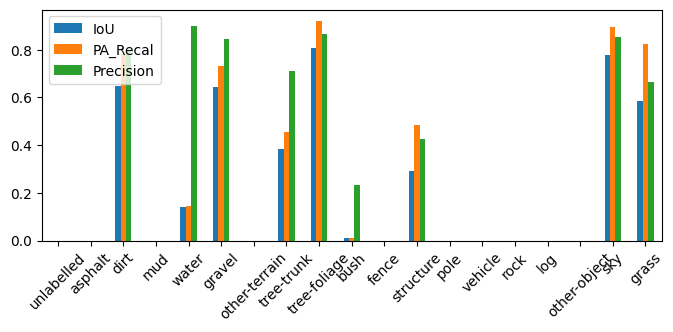

In [44]:
result_df_deeplabv3.plot(kind='bar', figsize=(8, 3), rot=45)
plt.show()

## Ensemble

/root/miniconda3/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FCN_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/root/miniconda3/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=D

Epoch 1/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.38it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.785]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.32it/s]

Validation metric:
mIoU: 13.62
mPA: 18.16
Accuracy: 75.32
plot valid image


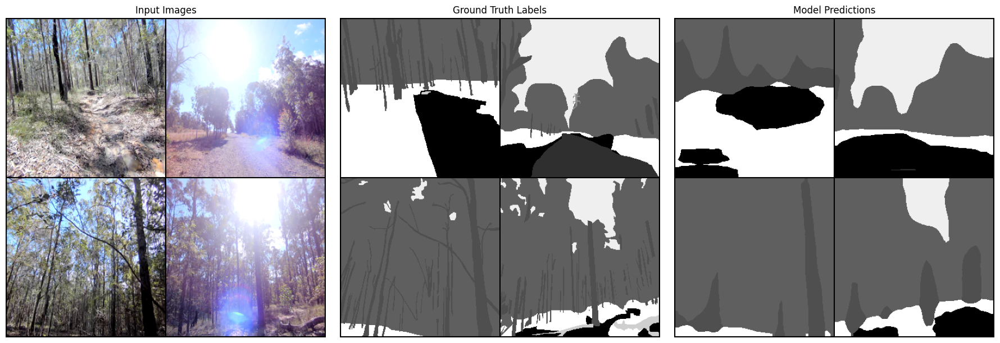

Epoch 2/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.35it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.579]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.30it/s]

Validation metric:
mIoU: 16.73
mPA: 20.68
Accuracy: 79.48
plot valid image


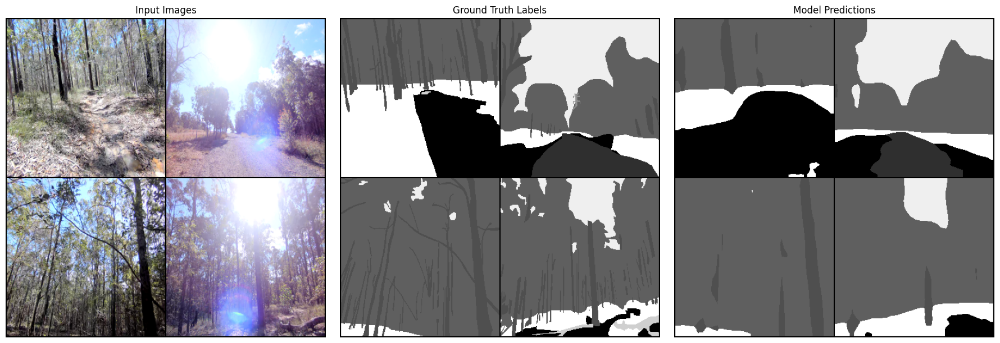

Epoch 3/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.28it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.545]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.31it/s]

Validation metric:
mIoU: 18.32
mPA: 24.31
Accuracy: 80.13
plot valid image


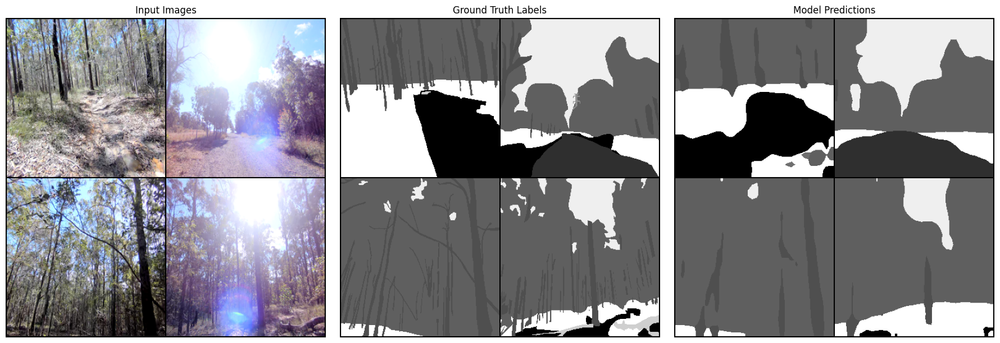

Epoch 4/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.25it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.512]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.10it/s]

Validation metric:
mIoU: 20.03
mPA: 24.53
Accuracy: 81.13
plot valid image


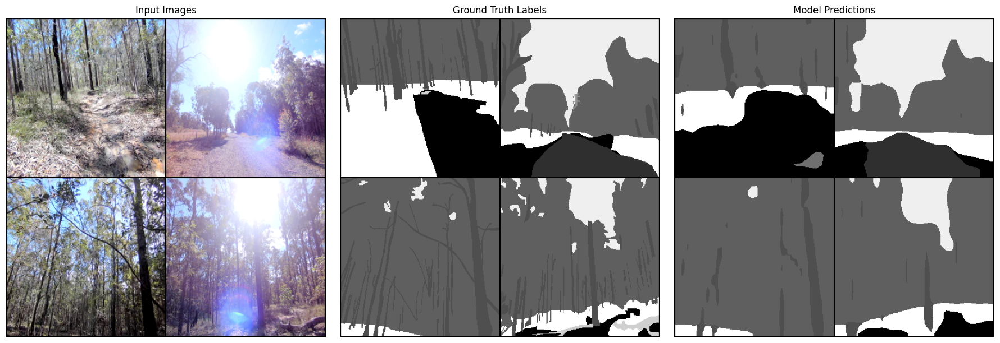

Epoch 5/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.24it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.5]  


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.08it/s]

Validation metric:
mIoU: 22.39
mPA: 26.67
Accuracy: 81.43
plot valid image


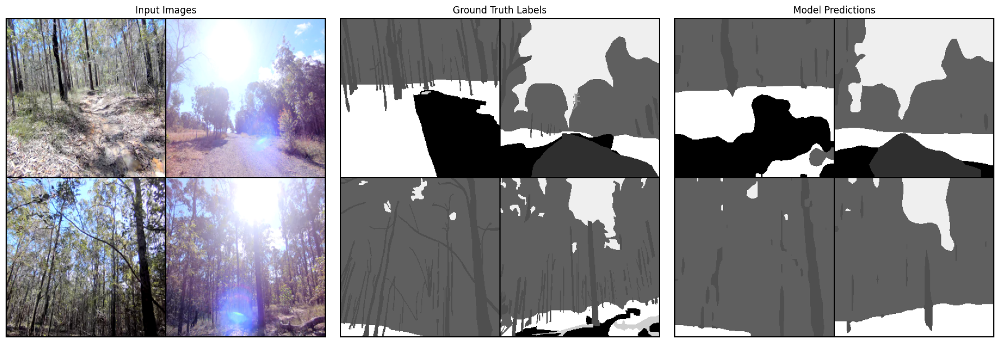

Epoch 6/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.23it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.49] 


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.31it/s]

Validation metric:
mIoU: 23.30
mPA: 27.62
Accuracy: 81.75
plot valid image


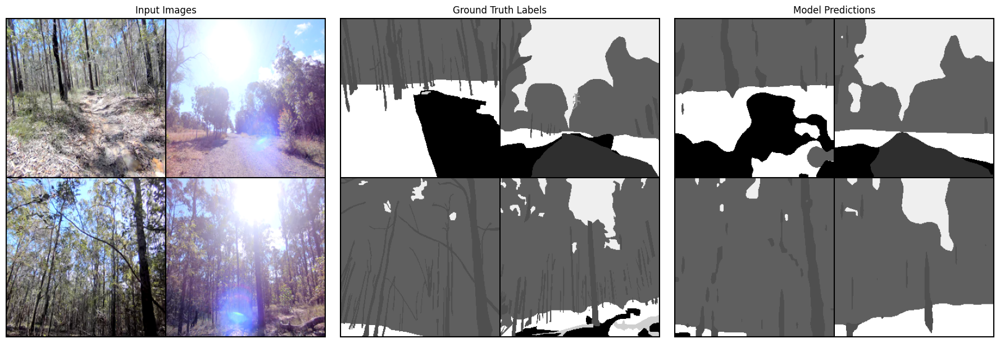

Epoch 7/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.39it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.494]


Epoch 8/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.39it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.491]


Epoch 9/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.40it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.488]


Saved Best Model


compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]

Validation metric:
mIoU: 31.77
mPA: 43.53
Accuracy: 82.09
plot valid image


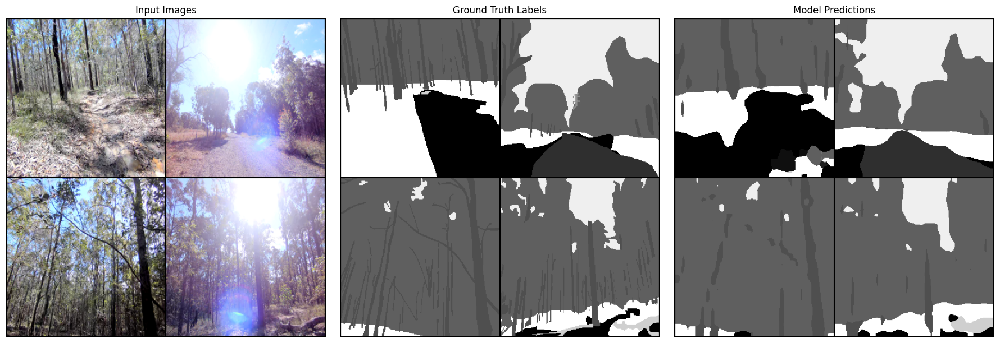

Epoch 10/10


Validating: 100%|██████████| 6/6 [00:02<00:00,  2.40it/s, gpu_memory=11.77 GB, lr=0.0001, valid_loss=0.501]


In [11]:
from torchvision.models.segmentation.fcn import FCNHead
from torchvision.models.segmentation.deeplabv3 import DeepLabHead
import pandas as pd

model_fcn = torchvision.models.segmentation.fcn_resnet50(pretrained=True)
model_fcn.classifier = FCNHead(2048, 128)

model_deeplabv3 = torchvision.models.segmentation.deeplabv3_resnet50(pretrained=True)
model_deeplabv3.classifier = DeepLabHead(2048, 128)


class MyEnsembleModel(nn.Module):
    def __init__(self, model1, model2, num_classes):
        super(MyEnsembleModel, self).__init__()
        self.model1 = model1
        self.model2 = model2
        self.cnn = nn.Conv2d(128, num_classes, kernel_size=(1, 1), stride=(1, 1))
    def forward(self,x):
        v1 = self.model1(x)['out']
        v2 = self.model2(x)['out']
        x = v1+v2
        x = self.cnn(x)
        return {'out': x}
        
my_model = MyEnsembleModel(model_fcn, model_deeplabv3, num_classes)


my_model.to(device)

optimizer = optim.Adam(my_model.parameters(), lr=1e-4, weight_decay=1e-6)

runner = ModelTrainValid(my_model, device, num_classes, train_loader, val_loader, test_loader, optimizer)
model_model_my, history_model_my = runner.do_training(num_epochs=10, save_name='model_my')


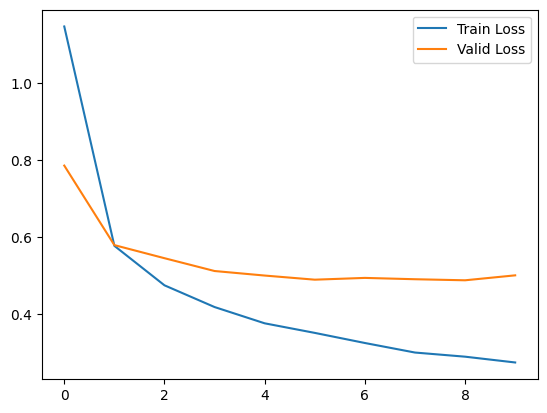

In [12]:
df = pd.DataFrame(history_model_my)
df.plot()
plt.show()

### test

In [13]:
IoUs, PA_Recall, Precision = runner.mIoU_compute(runner.test_loader)

result_data_my = {name_classes[i]: (IoUs[i], PA_Recall[i], Precision[i]) for i in range(num_classes)}

result_df_my = pd.DataFrame(result_data_my).T
result_df_my.rename(columns={0: 'IoU', 1:'PA_Recal', 2:'Precision'}, inplace=True)
result_df_my

compute_mIoU: 100%|██████████| 6/6 [00:02<00:00,  2.23it/s]

Validation metric:
mIoU: 28.40
mPA: 36.45
Accuracy: 81.48


,IoU,PA_Recal,Precision
unlabelled,0.000000,0.000000,0.000000
asphalt,0.000000,0.000000,0.000000
dirt,0.623903,0.752683,0.784786
mud,0.037206,0.078744,0.065885
water,0.022454,0.022454,1.000000
gravel,0.692818,0.940766,0.724419
other-terrain,0.000000,0.000000,0.000000
tree-trunk,0.387172,0.484904,0.657649
tree-foliage,0.809874,0.925484,0.866368
bush,0.161117,0.247811,0.315324


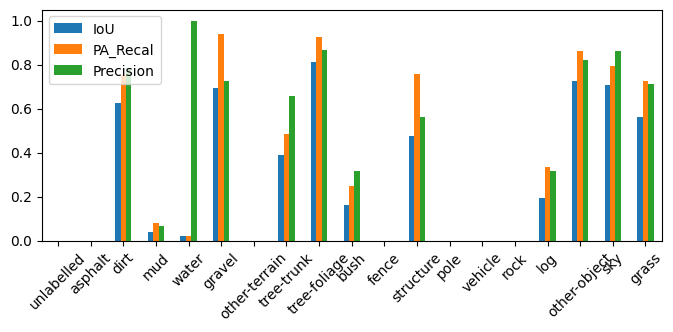

In [14]:
result_df_my.plot(kind='bar', figsize=(8, 3), rot=45)
plt.show()